In [58]:
import subprocess
import os
import exifread
import csv
from IPython.display import Image
from PIL import Image
from PIL import ImageFont
from PIL import ImageDraw
from IPython.display import Image as displayimage
import pandas as pd 

In [59]:
res = subprocess.call(['date'])

cmd1 = ['aws', 's3', 'sync', 's3://ia628/class/images', './mybucket/rashidm/metadata/images']
cmd2  = ['aws', 's3', 'sync', 's3://ia628/class/', './']
res1 = subprocess.check_output(cmd1)
res2  = subprocess.check_output(cmd2)

print(res1.decode())
print(res2.decode())

Mon Mar  6 06:48:31 UTC 2023
download: s3://ia628/class/images/marketst670503.jpg to mybucket/rashidm/metadata/images/marketst670503.jpg
download: s3://ia628/class/images/construction02-6709.jpg to mybucket/rashidm/metadata/images/construction02-6709.jpg
download: s3://ia628/class/images/construction01.jpg to mybucket/rashidm/metadata/images/construction01.jpg
download: s3://ia628/class/images/marketst8407.jpg to mybucket/rashidm/metadata/images/marketst8407.jpg
download: s3://ia628/class/images/classof1971-670917a.jpg to mybucket/rashidm/metadata/images/classof1971-670917a.jpg

download: s3://ia628/class/Colombia.ttf to ./Colombia.ttf         
download: s3://ia628/class/images/construction01.jpg to images/construction01.jpg
download: s3://ia628/class/images/marketst670503.jpg to images/marketst670503.jpg
download: s3://ia628/class/images/construction02-6709.jpg to images/construction02-6709.jpg
download: s3://ia628/class/images/classof1971-670917a.jpg to images/classof1971-670917a.jpg

In [60]:
#Created these directories for purpose

dir_list_creat = ["mybucket/rashidm/metadata/csv/", "mybucket/rashidm/metadata/imprinted/"]
for dir_name in dir_list_creat: 
        #Check the directory name exist or not
    if os.path.isdir(dir_name) == False:
        #Create the directory
        os.mkdir(dir_name)
        #Print success message
        print("The directory is created.")
    else:
        #Print the message if the directory exists
        print("The directory already exists.")

The directory is created.
The directory is created.


In [61]:
input_path = "mybucket/rashidm/metadata/images"
csv_loc = 'mybucket/rashidm/metadata/csv/metadata.csv'
input_path = "mybucket/rashidm/metadata/images"
output_imprinted = 'mybucket/rashidm/metadata/imprinted'

mybucket/rashidm/metadata/images/classof1971-670917a.jpg


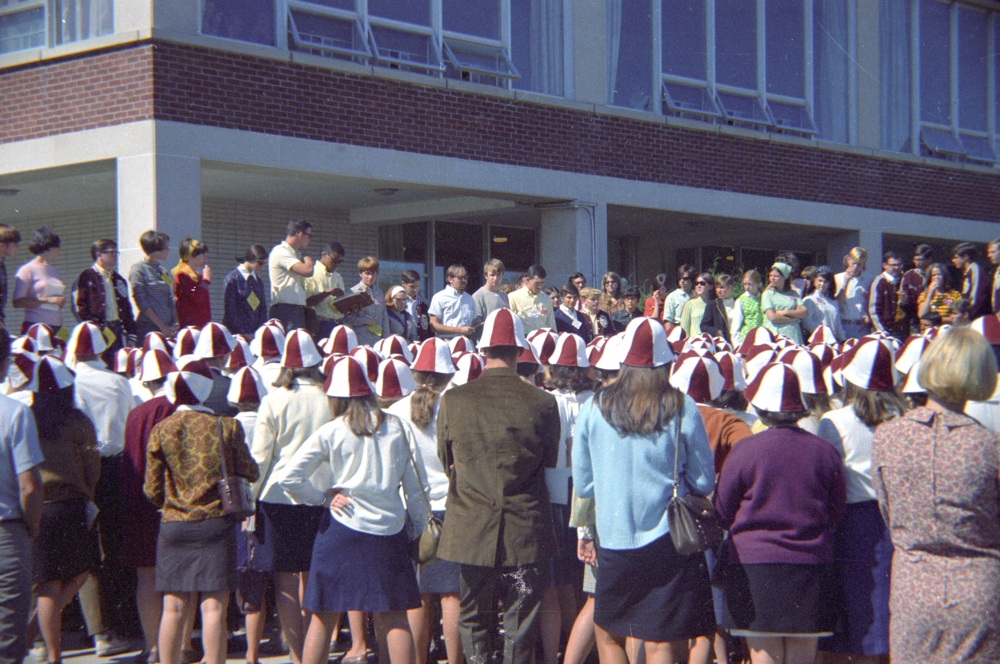

dict_keys(['Image ImageDescription', 'Image Orientation', 'Image XResolution', 'Image YResolution', 'Image ResolutionUnit', 'Image Software', 'Image DateTime', 'Image ExifOffset', 'Thumbnail Compression', 'Thumbnail XResolution', 'Thumbnail YResolution', 'Thumbnail ResolutionUnit', 'Thumbnail JPEGInterchangeFormat', 'Thumbnail JPEGInterchangeFormatLength', 'EXIF ColorSpace', 'EXIF ExifImageWidth', 'EXIF ExifImageLength', 'JPEGThumbnail'])
Freshmen (Class of 1971) at a noon meeting, the State University of New York, College at Potsdam, Potsdam, N.Y.  17 September 1967
mybucket/rashidm/metadata/images/marketst8407.jpg


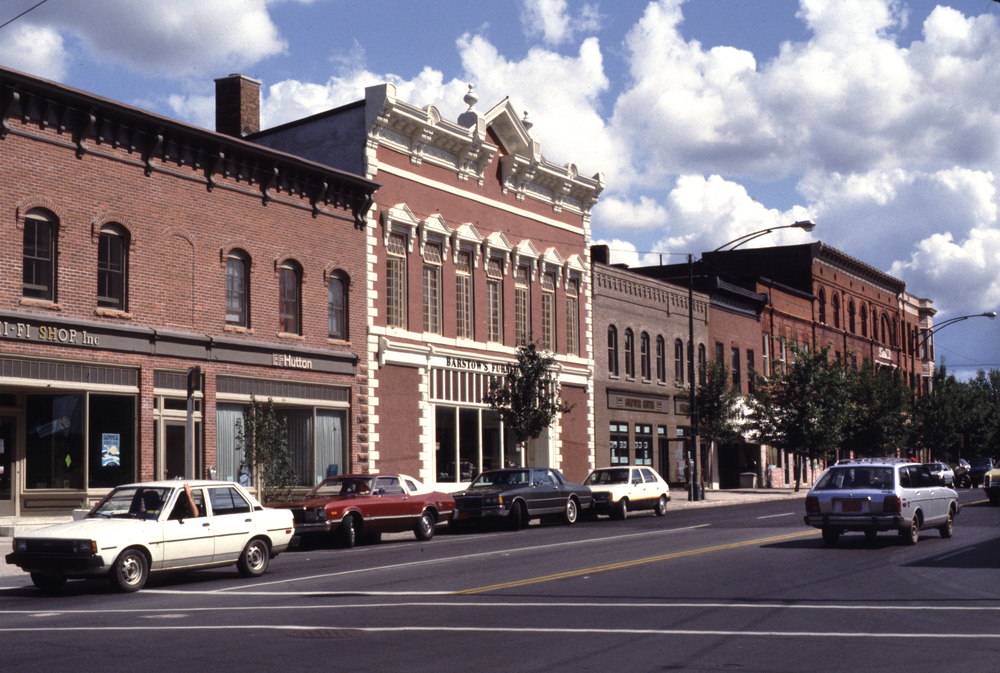

dict_keys(['Image ImageDescription', 'Image Orientation', 'Image XResolution', 'Image YResolution', 'Image ResolutionUnit', 'Image Software', 'Image DateTime', 'Image ExifOffset', 'Thumbnail Compression', 'Thumbnail XResolution', 'Thumbnail YResolution', 'Thumbnail ResolutionUnit', 'Thumbnail JPEGInterchangeFormat', 'Thumbnail JPEGInterchangeFormatLength', 'EXIF ColorSpace', 'EXIF ExifImageWidth', 'EXIF ExifImageLength', 'JPEGThumbnail'])
Market Street, Potsdam, N.Y.  July 1984  
mybucket/rashidm/metadata/images/construction02-6709.jpg


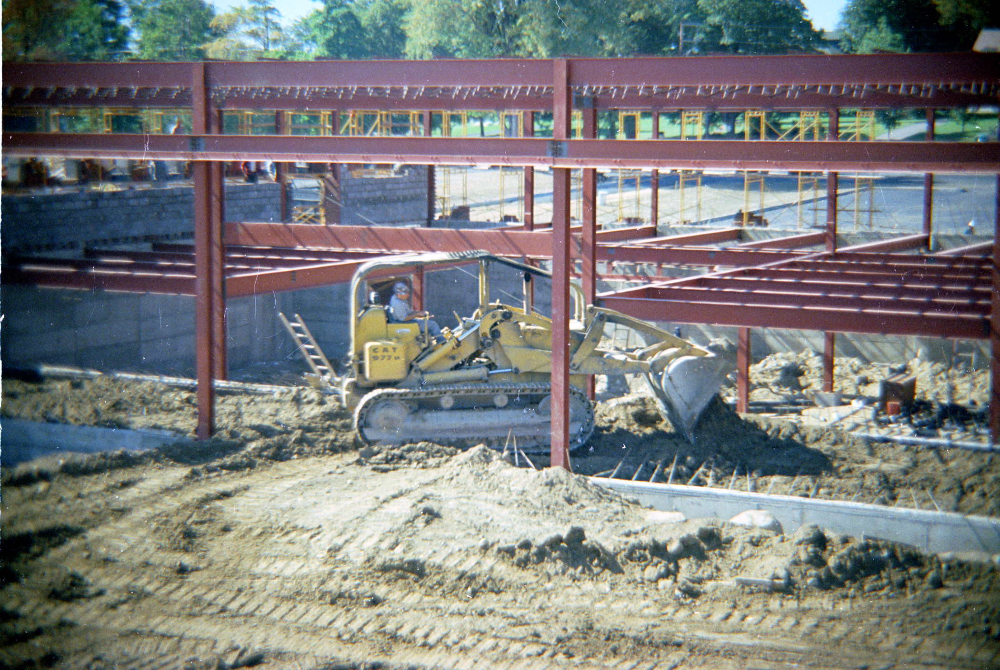

dict_keys(['Image Orientation', 'Image XResolution', 'Image YResolution', 'Image ResolutionUnit', 'Image Software', 'Image DateTime', 'Image ExifOffset', 'Thumbnail Compression', 'Thumbnail XResolution', 'Thumbnail YResolution', 'Thumbnail ResolutionUnit', 'Thumbnail JPEGInterchangeFormat', 'Thumbnail JPEGInterchangeFormatLength', 'EXIF ColorSpace', 'EXIF ExifImageWidth', 'EXIF ExifImageLength', 'JPEGThumbnail'])
mybucket/rashidm/metadata/images/construction01.jpg


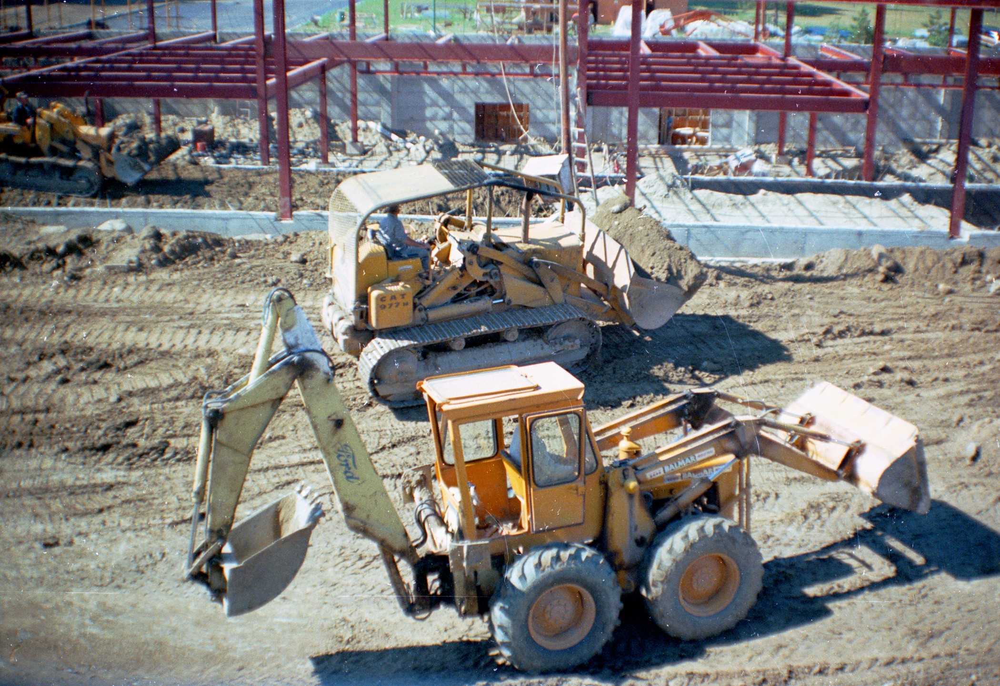

dict_keys(['Image ImageDescription', 'Image Orientation', 'Image XResolution', 'Image YResolution', 'Image ResolutionUnit', 'Image Software', 'Image DateTime', 'Image ExifOffset', 'Thumbnail Compression', 'Thumbnail XResolution', 'Thumbnail YResolution', 'Thumbnail ResolutionUnit', 'Thumbnail JPEGInterchangeFormat', 'Thumbnail JPEGInterchangeFormatLength', 'EXIF ColorSpace', 'EXIF ExifImageWidth', 'EXIF ExifImageLength', 'JPEGThumbnail'])
Construction at Potsdam. 1967
mybucket/rashidm/metadata/images/marketst670503.jpg


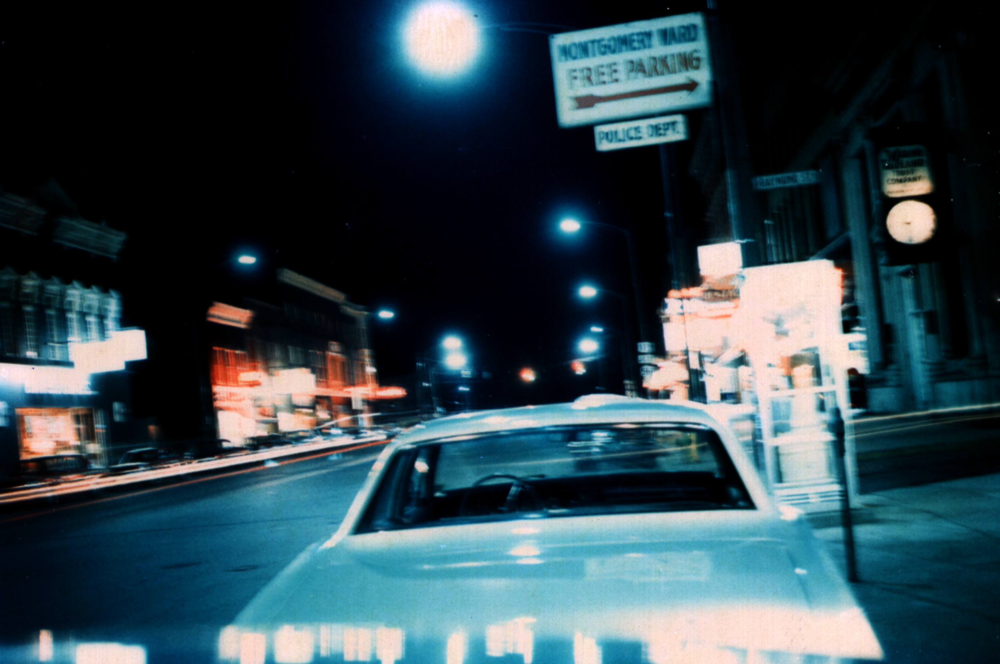

dict_keys(['Image ImageDescription', 'Image Orientation', 'Image XResolution', 'Image YResolution', 'Image ResolutionUnit', 'Image Software', 'Image DateTime', 'Image ExifOffset', 'Thumbnail Compression', 'Thumbnail XResolution', 'Thumbnail YResolution', 'Thumbnail ResolutionUnit', 'Thumbnail JPEGInterchangeFormat', 'Thumbnail JPEGInterchangeFormatLength', 'EXIF ColorSpace', 'EXIF ExifImageWidth', 'EXIF ExifImageLength', 'JPEGThumbnail'])
Market Street, downtown Potsdam,N.Y.  3 May 1967


In [62]:
#get the list of images names (file names) 
dir_list = os.listdir(input_path)
#print(dir_list)
fields = ['file','image_description']
rows = []

for f in dir_list:
    file = os.path.join(input_path, f)
    print(file)
    f_open =open(file,'rb')
    display(displayimage(filename = file))
    tags = exifread.process_file(f_open)
    print(tags.keys())
    try: 
        row= {'file':f,'image_description':tags["Image ImageDescription"]}
        rows.append(row)
        print(tags['Image ImageDescription'])
    except: 
        row= {'file':f,'image_description':'no description'}
        rows.append(row)
    
    c = open(csv_loc, 'w')
    writer = csv.DictWriter(c, fieldnames = fields,lineterminator='\n')  
    writer.writeheader()
    writer.writerows(rows)      
    c.close()
    f_open.close()


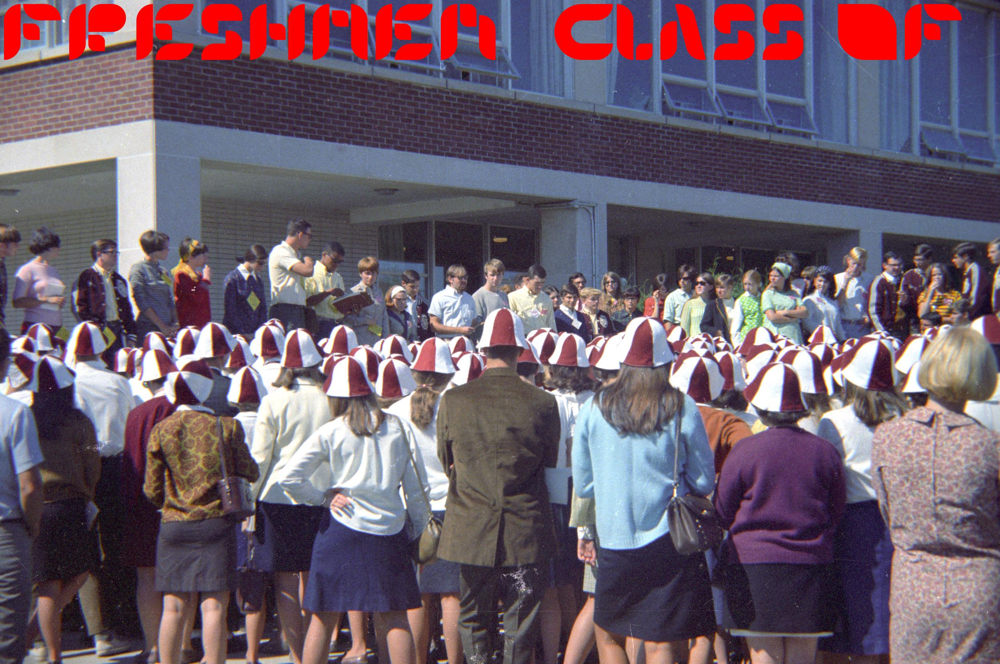

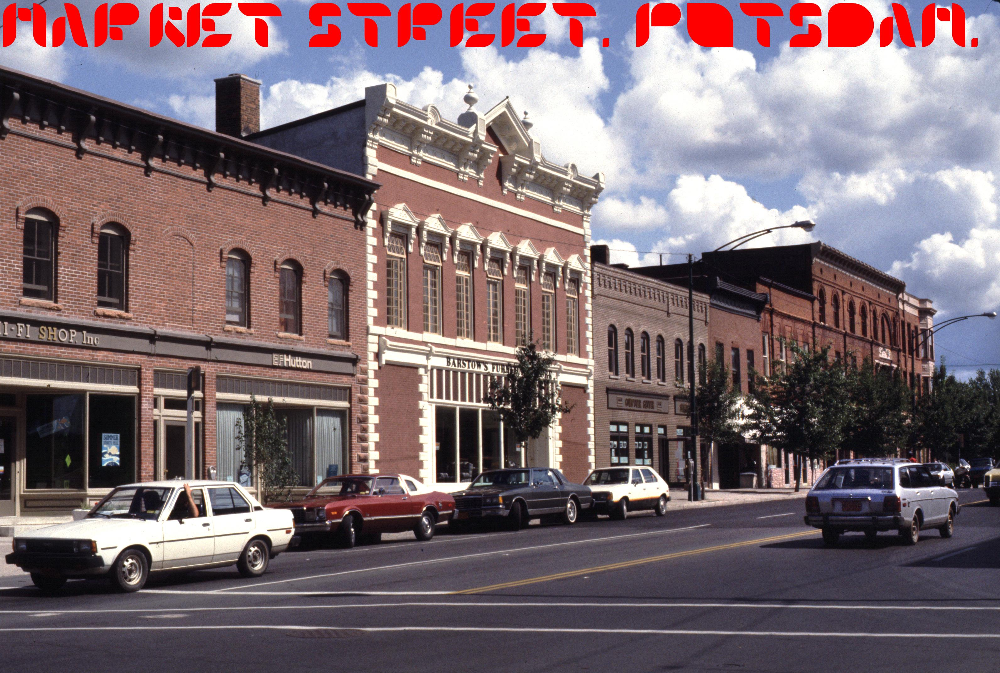

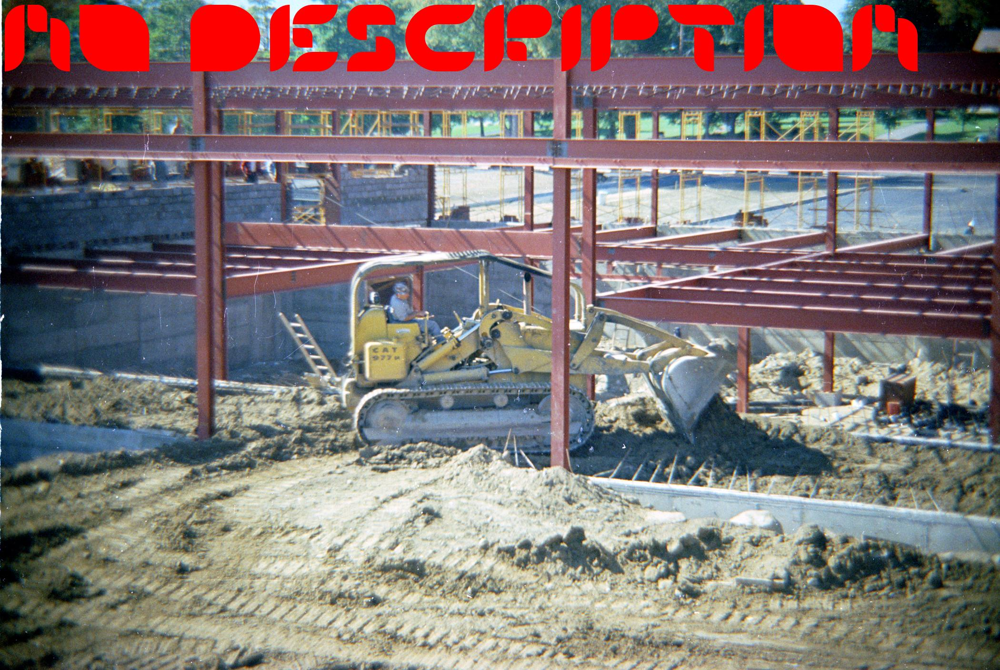

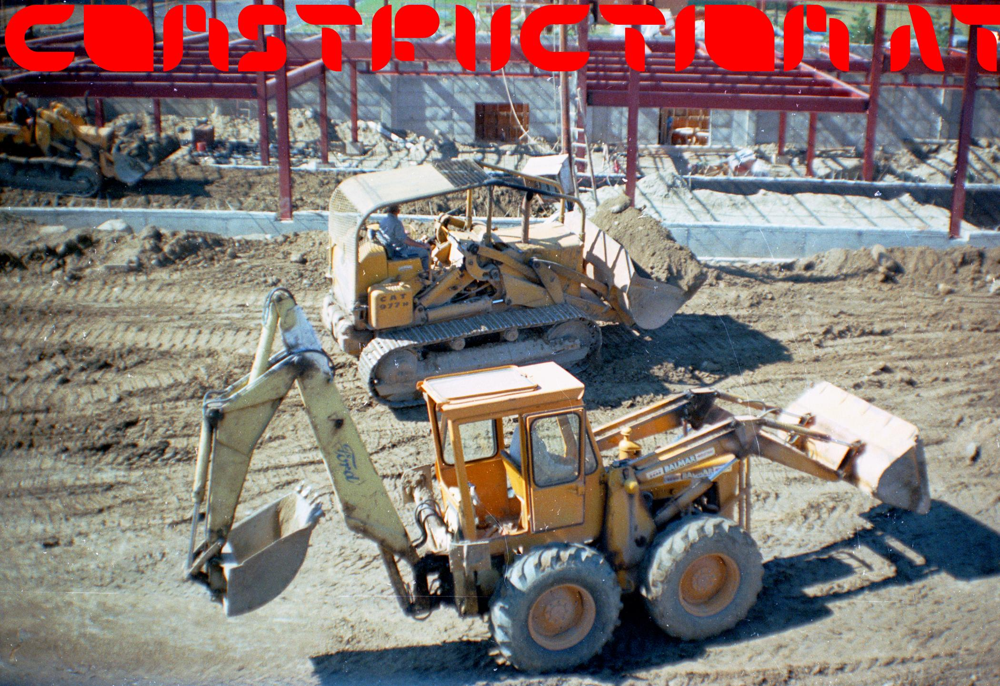

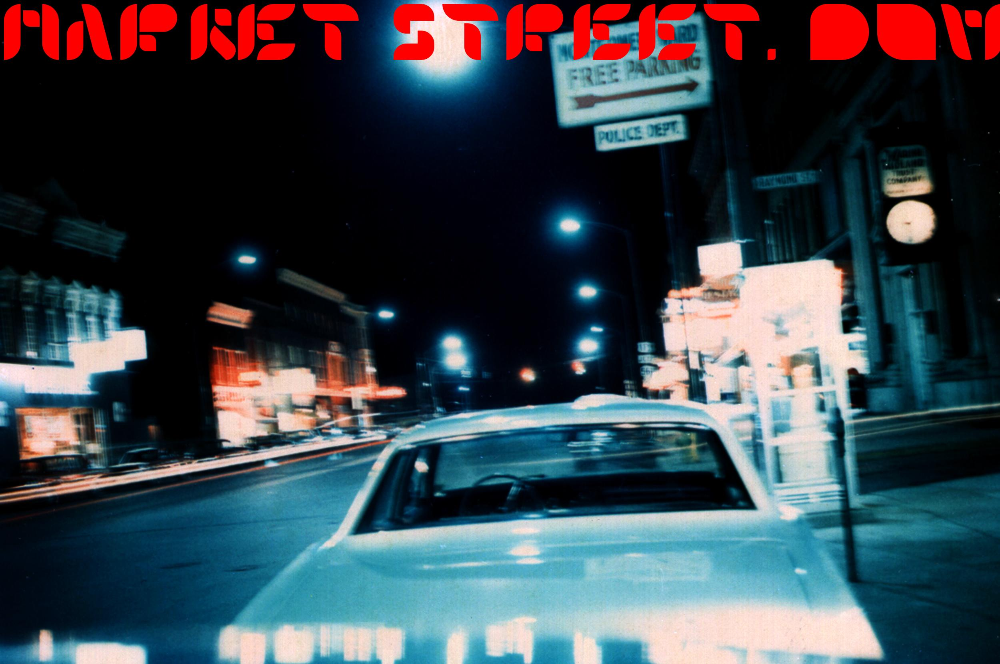

In [63]:
df = pd.read_csv(csv_loc)

#for f in dir_list:
for index, row in df.iterrows():
    f = dir_list[index]
    file = os.path.join(input_path, f)
    #file = 'mydata/sample.jpg'
    outfile = output_imprinted + '/new_' + f
    #outfile = 'sample-text.jpg'
    
    img = Image.open(file)
    draw = ImageDraw.Draw(img)
    # font = ImageFont.truetype(<font-file>, <font-size>)
    font = ImageFont.truetype("Colombia.ttf", 200)
    draw.text((0, 0),row['image_description'],(255,0,0),font=font)
    img.save(outfile)

    display(displayimage(filename=outfile))

In [64]:
#uploaded the folders back to s3

cmd3 = ['aws', 's3', 'sync', './mybucket', 's3://ia628/']
print(subprocess.check_output(cmd3))

b'Completed 399 Bytes/~24.6 MiB (13.8 KiB/s) with ~10 file(s) remaining (calculating...)\rupload: mybucket/rashidm/metadata/csv/metadata.csv to s3://ia628/rashidm/metadata/csv/metadata.csv\nCompleted 399 Bytes/~24.6 MiB (13.8 KiB/s) with ~9 file(s) remaining (calculating...)\rCompleted 256.4 KiB/25.5 MiB (4.9 MiB/s) with 10 file(s) remaining                   \rCompleted 300.2 KiB/25.5 MiB (2.8 MiB/s) with 10 file(s) remaining                   \rupload: mybucket/rashidm/metadata/imprinted/new_marketst670503.jpg to s3://ia628/rashidm/metadata/imprinted/new_marketst670503.jpg\nCompleted 300.2 KiB/25.5 MiB (2.8 MiB/s) with 9 file(s) remaining\rCompleted 556.2 KiB/25.5 MiB (4.5 MiB/s) with 9 file(s) remaining\rCompleted 812.2 KiB/25.5 MiB (6.5 MiB/s) with 9 file(s) remaining\rCompleted 1.0 MiB/25.5 MiB (8.4 MiB/s) with 9 file(s) remaining  \rCompleted 1.3 MiB/25.5 MiB (9.5 MiB/s) with 9 file(s) remaining  \rCompleted 1.5 MiB/25.5 MiB (11.8 MiB/s) with 9 file(s) remaining \rCompleted 1.8 M